<a href="https://colab.research.google.com/github/ManikantaPinabakala/slashMarkProject6/blob/main/SlashMark_Project_6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Project Beginning

In [9]:
!pip install catboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 10.0 MB/s eta 0:00:00


In [10]:
# General Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
# File Path Processing Libraries
import os
import os.path
from pathlib import Path
import glob
# Image Processing Libraries
from PIL import Image
from keras.preprocessing import image
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2
from keras.applications.vgg16 import preprocess_input, decode_predictions
# Scaling & Transformation Libraries
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from keras import regularizers
from sklearn.preprocessing import LabelEncoder
# Accuracy Control
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, roc_auc_score, roc_curve
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score
# Optimizer
from keras.optimizers import RMSprop,Adam,Optimizer,Optimizer
# Model layers
from tensorflow.keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D, BatchNormalization,MaxPooling2D,BatchNormalization,\
                        Permute, TimeDistributed, Bidirectional,GRU, SimpleRNN, LSTM, GlobalAveragePooling2D, SeparableConv2D
from keras import models
from keras import layers
from keras.applications import VGG16,VGG19,inception_v3
from keras import backend as K
from keras.utils import plot_model
# Sklearn classifiers
from xgboost import XGBClassifier, XGBRegressor
from lightgbm import LGBMClassifier, LGBMRegressor
from catboost import CatBoostClassifier, CatBoostRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.ensemble import GradientBoostingClassifier, GradientBoostingRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.neural_network import MLPClassifier, MLPRegressor
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.linear_model import LinearRegression
from sklearn.cross_decomposition import PLSRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import Lasso
from sklearn.linear_model import LassoCV
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import ElasticNetCV
# Ignoring Warnings
from warnings import filterwarnings
filterwarnings("ignore", category=DeprecationWarning)
filterwarnings("ignore", category=FutureWarning)
filterwarnings("ignore", category=UserWarning)

# Importing datasets

In [11]:
Fire_Dataset_Path = Path("fire_dataset/")

In [12]:
PNG_Path = list(Fire_Dataset_Path.glob(r"*/*.png"))

In [13]:
PNG_Labels = list(map(lambda x: os.path.split(os.path.split(x)[0])[1], PNG_Path))

In [14]:
print("FIRE: ", PNG_Labels.count("fire_images"))
print("NO_FIRE: ", PNG_Labels.count("non_fire_images"))

FIRE:  755
NO_FIRE:  244


# Transformation to Series

In [15]:
PNG_Path_Series = pd.Series(PNG_Path,name="PNG").astype(str)
PNG_Labels_Series = pd.Series(PNG_Labels,name="CATEGORY")

In [16]:
PNG_Path_Series

0      fire_dataset/non_fire_images/non_fire.110.png
1      fire_dataset/non_fire_images/non_fire.223.png
2       fire_dataset/non_fire_images/non_fire.73.png
3      fire_dataset/non_fire_images/non_fire.119.png
4      fire_dataset/non_fire_images/non_fire.241.png
                           ...                      
994            fire_dataset/fire_images/fire.348.png
995             fire_dataset/fire_images/fire.32.png
996            fire_dataset/fire_images/fire.705.png
997            fire_dataset/fire_images/fire.639.png
998             fire_dataset/fire_images/fire.69.png
Name: PNG, Length: 999, dtype: object

In [17]:
PNG_Labels_Series

0      non_fire_images
1      non_fire_images
2      non_fire_images
3      non_fire_images
4      non_fire_images
            ...       
994        fire_images
995        fire_images
996        fire_images
997        fire_images
998        fire_images
Name: CATEGORY, Length: 999, dtype: object

In [18]:
PNG_Labels_Series.replace({"non_fire_images":"NO_FIRE", "fire_images":"FIRE"}, inplace=True)

In [19]:
PNG_Labels_Series

0      NO_FIRE
1      NO_FIRE
2      NO_FIRE
3      NO_FIRE
4      NO_FIRE
        ...   
994       FIRE
995       FIRE
996       FIRE
997       FIRE
998       FIRE
Name: CATEGORY, Length: 999, dtype: object

# Transformation to DataFrame

In [20]:
Main_Train_Data = pd.concat([PNG_Path_Series, PNG_Labels_Series], axis=1)

In [21]:
Main_Train_Data.head(-1)

,PNG,CATEGORY
0,fire_dataset/non_fire_images/non_fire.110.png,NO_FIRE
1,fire_dataset/non_fire_images/non_fire.223.png,NO_FIRE
2,fire_dataset/non_fire_images/non_fire.73.png,NO_FIRE
3,fire_dataset/non_fire_images/non_fire.119.png,NO_FIRE
4,fire_dataset/non_fire_images/non_fire.241.png,NO_FIRE
...,...,...
993,fire_dataset/fire_images/fire.420.png,FIRE
994,fire_dataset/fire_images/fire.348.png,FIRE
995,fire_dataset/fire_images/fire.32.png,FIRE
996,fire_dataset/fire_images/fire.705.png,FIRE


# Shuffling Dataset

In [22]:
Main_Train_Data = Main_Train_Data.sample(frac=1).reset_index(drop=True)

In [23]:
Main_Train_Data.head(-1)

,PNG,CATEGORY
0,fire_dataset/fire_images/fire.418.png,FIRE
1,fire_dataset/fire_images/fire.681.png,FIRE
2,fire_dataset/fire_images/fire.74.png,FIRE
3,fire_dataset/fire_images/fire.90.png,FIRE
4,fire_dataset/non_fire_images/non_fire.221.png,NO_FIRE
...,...,...
993,fire_dataset/fire_images/fire.638.png,FIRE
994,fire_dataset/fire_images/fire.203.png,FIRE
995,fire_dataset/non_fire_images/non_fire.132.png,NO_FIRE
996,fire_dataset/fire_images/fire.222.png,FIRE


Here, the image number 189 is broken, so let's remove its data from the df.

In [24]:
remove_PNG = 'fire_dataset/non_fire_images/non_fire.189.png'
Main_Train_Data = Main_Train_Data.loc[~(Main_Train_Data.loc[:, 'PNG'] == remove_PNG), :]

In [25]:
print(Main_Train_Data.loc[Main_Train_Data.loc[:, 'PNG'] == remove_PNG, :])

Empty DataFrame
Columns: [PNG, CATEGORY]
Index: []


In [26]:
Main_Train_Data.head(-1)

,PNG,CATEGORY
0,fire_dataset/fire_images/fire.418.png,FIRE
1,fire_dataset/fire_images/fire.681.png,FIRE
2,fire_dataset/fire_images/fire.74.png,FIRE
3,fire_dataset/fire_images/fire.90.png,FIRE
4,fire_dataset/non_fire_images/non_fire.221.png,NO_FIRE
...,...,...
993,fire_dataset/fire_images/fire.638.png,FIRE
994,fire_dataset/fire_images/fire.203.png,FIRE
995,fire_dataset/non_fire_images/non_fire.132.png,NO_FIRE
996,fire_dataset/fire_images/fire.222.png,FIRE


# Visualization

In [27]:
plt.style.use('dark_background')

## General

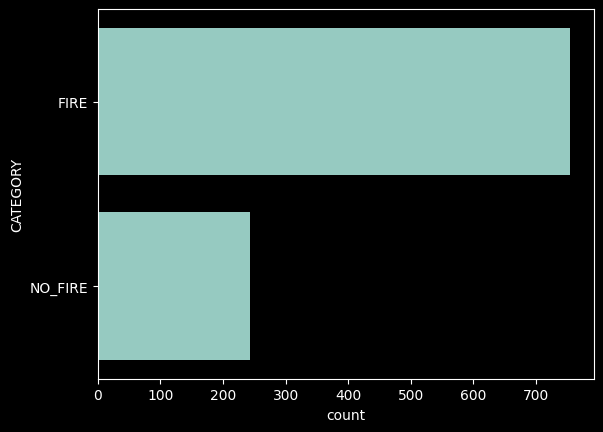

In [28]:
sns.countplot(Main_Train_Data["CATEGORY"])
plt.show()

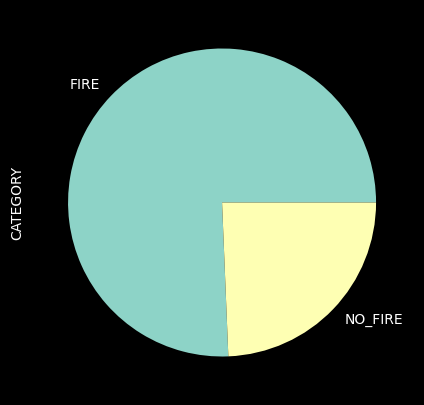

In [29]:
Main_Train_Data['CATEGORY'].value_counts().plot.pie(figsize=(5,5))
plt.show()

## Images

Text(0.5, 1.0, 'FIRE')

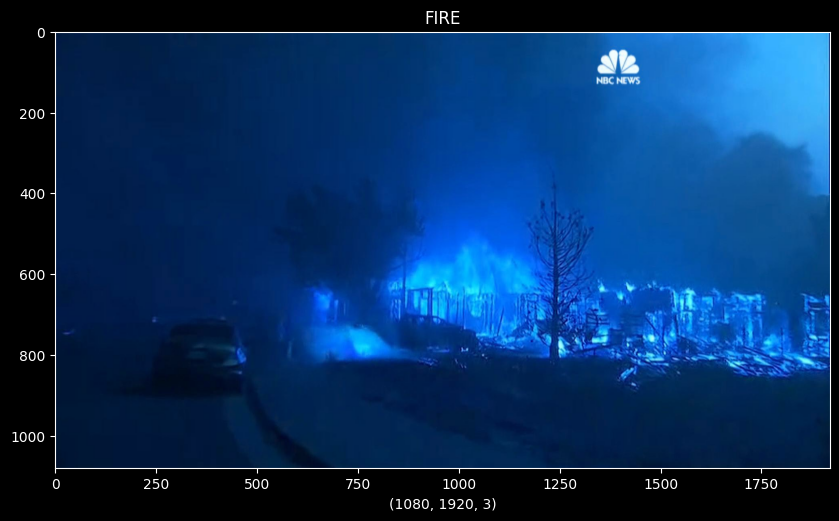

In [30]:
figure = plt.figure(figsize=(10, 10))
x = cv2.imread(Main_Train_Data["PNG"][0])
plt.imshow(x)
plt.xlabel(x.shape)
plt.title(Main_Train_Data["CATEGORY"][0])

Text(0.5, 1.0, 'FIRE')

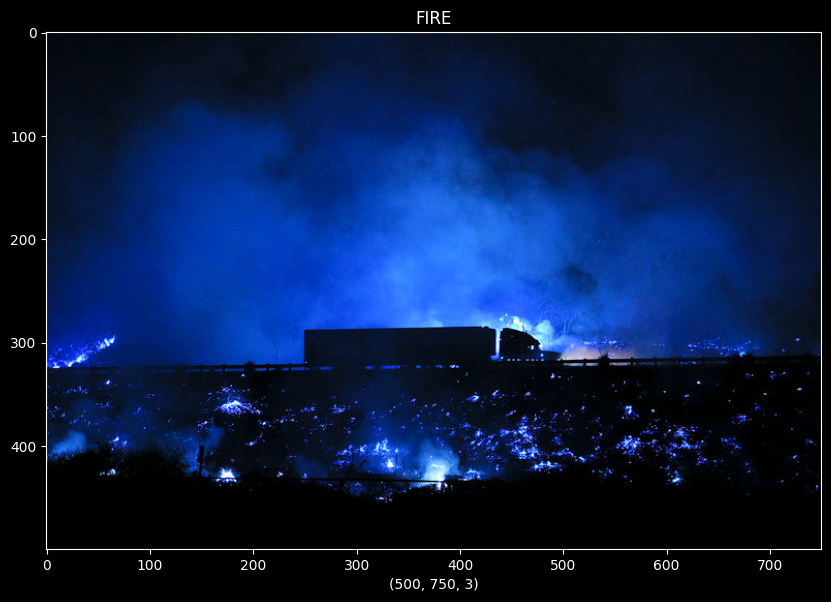

In [31]:
figure = plt.figure(figsize=(10, 10))
x = cv2.imread(Main_Train_Data["PNG"][993])
plt.imshow(x)
plt.xlabel(x.shape)
plt.title(Main_Train_Data["CATEGORY"][993])

Text(0.5, 1.0, 'NO_FIRE')

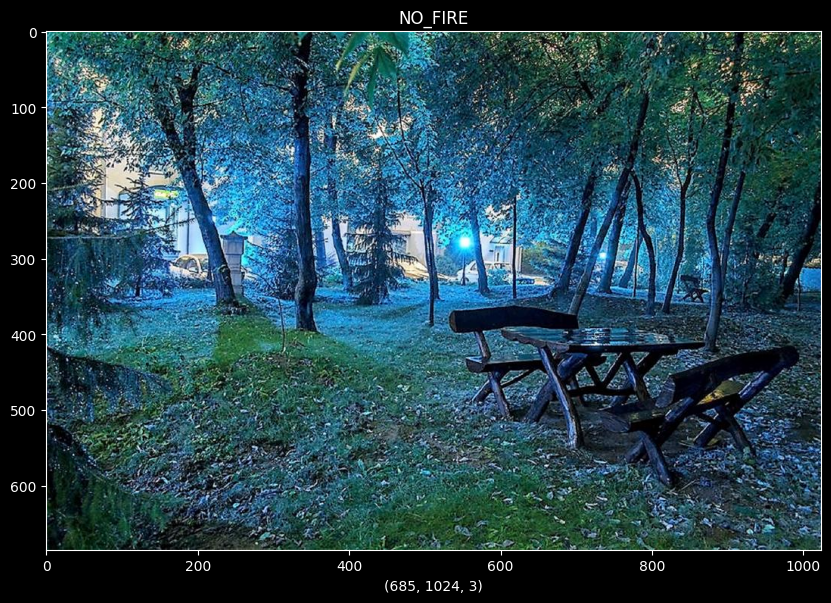

In [32]:
figure = plt.figure(figsize=(10, 10))
x = cv2.imread(Main_Train_Data["PNG"][20])
plt.imshow(x)
plt.xlabel(x.shape)
plt.title(Main_Train_Data["CATEGORY"][20])

Text(0.5, 1.0, 'NO_FIRE')

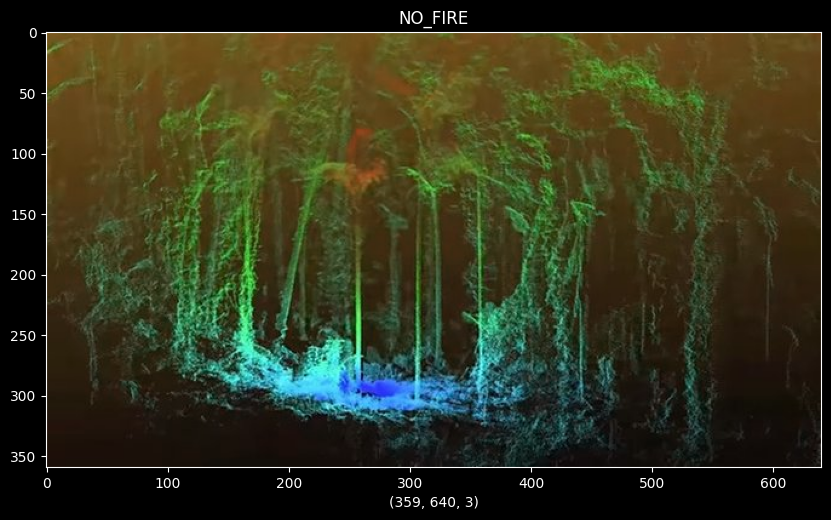

In [33]:
figure = plt.figure(figsize=(10, 10))
x = cv2.imread(Main_Train_Data["PNG"][48])
plt.imshow(x)
plt.xlabel(x.shape)
plt.title(Main_Train_Data["CATEGORY"][48])

## Multiple images

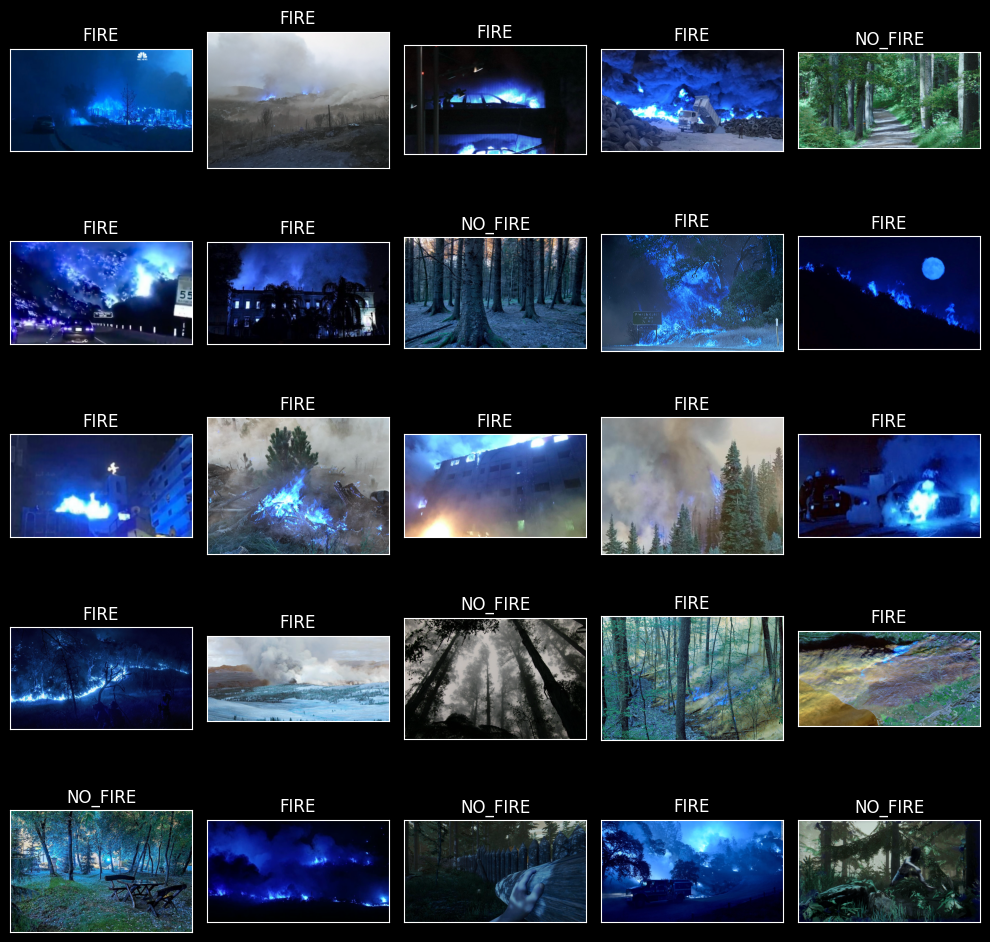

In [34]:
fig, axes = plt.subplots(nrows=5, ncols=5, figsize=(10, 10), subplot_kw={"xticks":[], "yticks":[]})

for i,ax in enumerate(axes.flat):
  ax.imshow(cv2.imread(Main_Train_Data["PNG"][i]))
  ax.set_title(Main_Train_Data["CATEGORY"][i])

plt.tight_layout()
plt.show()

## Multiple images in RGB

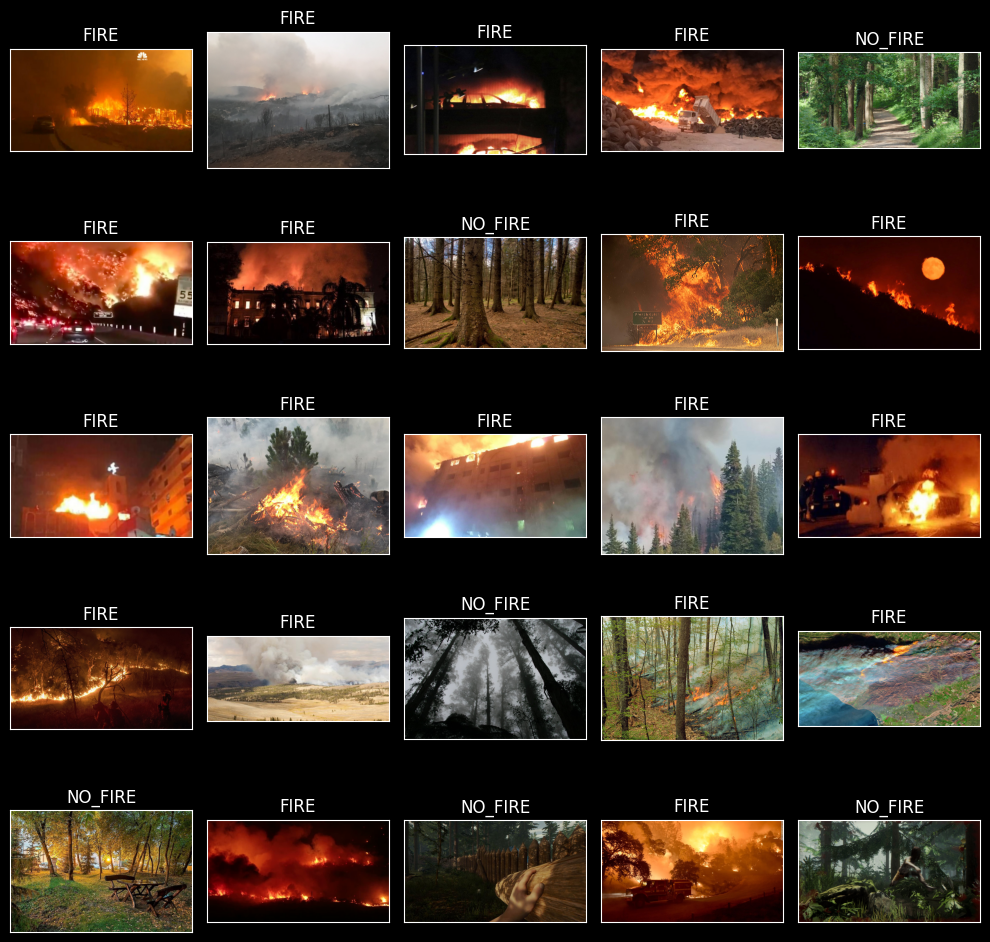

In [35]:
fig, axes = plt.subplots(nrows=5, ncols=5, figsize=(10, 10), subplot_kw={"xticks":[], "yticks":[]})

for i,ax in enumerate(axes.flat):
  x = cv2.imread(Main_Train_Data["PNG"][i])
  x = cv2.cvtColor(x, cv2.COLOR_RGB2BGR)
  ax.imshow(x)
  ax.set_title(Main_Train_Data["CATEGORY"][i])

plt.tight_layout()
plt.show()

# Determination of train and test datasets

## Image Generator

In [36]:
Train_Generator = ImageDataGenerator(rescale=1./255,
                                    shear_range=0.3,
                                    zoom_range=0.2,
                                    brightness_range=[0.2,0.9],
                                    rotation_range=30,
                                    horizontal_flip=True,
                                    vertical_flip=True,
                                    fill_mode="nearest",
                                    validation_split=0.1)

In [37]:
Test_Generator = ImageDataGenerator(rescale=1./255)

## Splitting train and test datasets

In [76]:
Train_Data,Test_Data = train_test_split(Main_Train_Data, test_size=0.1, random_state=42, shuffle=True)

In [77]:
print("Train dataset dimensions:", Train_Data.shape)
print("Test dataset dimensions:", Test_Data.shape)

Train dataset dimensions: (898, 2)
Test dataset dimensions: (100, 2)


In [78]:
print(Train_Data.head(-1))
print("----"*20)
print(Test_Data.head(-1))

                                               PNG CATEGORY
599          fire_dataset/fire_images/fire.624.png     FIRE
432           fire_dataset/fire_images/fire.75.png     FIRE
221          fire_dataset/fire_images/fire.466.png     FIRE
973   fire_dataset/non_fire_images/non_fire.65.png  NO_FIRE
525          fire_dataset/fire_images/fire.553.png     FIRE
..                                             ...      ...
71   fire_dataset/non_fire_images/non_fire.200.png  NO_FIRE
106          fire_dataset/fire_images/fire.546.png     FIRE
270          fire_dataset/fire_images/fire.664.png     FIRE
861          fire_dataset/fire_images/fire.268.png     FIRE
435  fire_dataset/non_fire_images/non_fire.199.png  NO_FIRE

[897 rows x 2 columns]
--------------------------------------------------------------------------------
                                               PNG CATEGORY
453          fire_dataset/fire_images/fire.336.png     FIRE
793   fire_dataset/non_fire_images/non_fire.51.png  NO_

In [79]:
print(Test_Data["CATEGORY"].value_counts())

FIRE       74
NO_FIRE    26
Name: CATEGORY, dtype: int64


In [80]:
encode = LabelEncoder()

In [81]:
For_Prediction_Class = encode.fit_transform(Test_Data["CATEGORY"])

## This is how generator's images look like

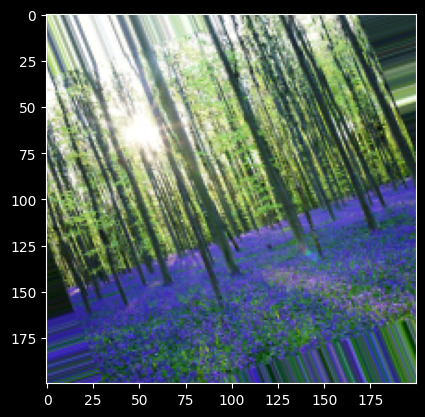

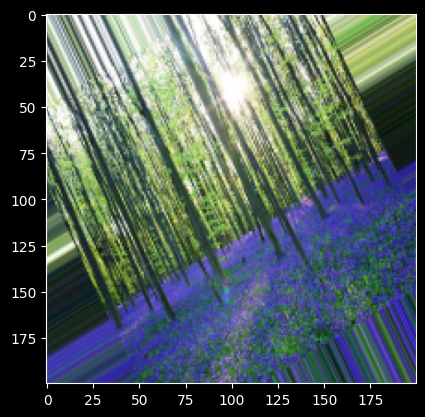

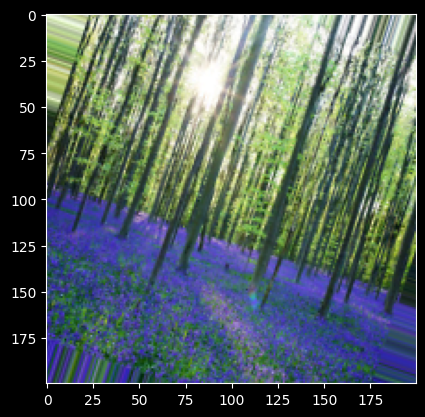

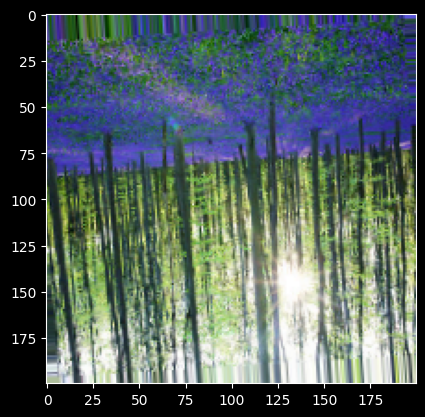

In [82]:
example_Image = Train_Data["PNG"][99]
Load_Image = image.load_img(example_Image, target_size=(200,200))
Array_Image = image.img_to_array(Load_Image)
Array_Image = Array_Image.reshape((1,) + Array_Image.shape)

i = 0

for batch in Train_Generator.flow(Array_Image, batch_size=1):
  plt.figure(i)
  IMG = plt.imshow(image.array_to_img(batch[0]))
  i += 1
  if i % 4 == 0:
    break

plt.show()

## Applying generator and transformation to Tensor

In [83]:
Train_IMG_Set = Train_Generator.flow_from_dataframe(dataframe=Train_Data,
                                                   x_col="PNG",
                                                   y_col="CATEGORY",
                                                   color_mode="rgb",
                                                   class_mode="categorical",
                                                   batch_size=32,
                                                   subset="training")

Found 809 validated image filenames belonging to 2 classes.


In [84]:
Validation_IMG_Set = Train_Generator.flow_from_dataframe(dataframe=Train_Data,
                                                   x_col="PNG",
                                                   y_col="CATEGORY",
                                                   color_mode="rgb",
                                                   class_mode="categorical",
                                                   batch_size=32,
                                                   subset="validation")

Found 89 validated image filenames belonging to 2 classes.


In [85]:
Test_IMG_Set = Test_Generator.flow_from_dataframe(dataframe=Test_Data,
                                                 x_col="PNG",
                                                 y_col="CATEGORY",
                                                 color_mode="rgb",
                                                 class_mode="categorical",
                                                 batch_size=32)

Found 100 validated image filenames belonging to 2 classes.


## Checking

In [86]:
for data_batch, label_batch in Train_IMG_Set:
  print("DATA SHAPE:", data_batch.shape)
  print("LABEL SHAPE:", label_batch.shape)
  break

DATA SHAPE: (32, 256, 256, 3)
LABEL SHAPE: (32, 2)


In [87]:
for data_batch, label_batch in Validation_IMG_Set:
  print("DATA SHAPE:", data_batch.shape)
  print("LABEL SHAPE:", label_batch.shape)
  break

DATA SHAPE: (32, 256, 256, 3)
LABEL SHAPE: (32, 2)


In [88]:
for data_batch, label_batch in Test_IMG_Set:
  print("DATA SHAPE:", data_batch.shape)
  print("LABEL SHAPE:", label_batch.shape)
  break

DATA SHAPE: (32, 256, 256, 3)
LABEL SHAPE: (32, 2)


In [89]:
print("Train:")
print(Train_IMG_Set.class_indices)
print(Train_IMG_Set.classes[0:5])
print(Train_IMG_Set.image_shape)
print("---"*20)
print("Validation:")
print(Validation_IMG_Set.class_indices)
print(Validation_IMG_Set.classes[0:5])
print(Validation_IMG_Set.image_shape)
print("---"*20)
print("Test:")
print(Test_IMG_Set.class_indices)
print(Test_IMG_Set.classes[0:5])
print(Test_IMG_Set.image_shape)

Train:
{'FIRE': 0, 'NO_FIRE': 1}
[1, 0, 0, 0, 1]
(256, 256, 3)
------------------------------------------------------------
Validation:
{'FIRE': 0, 'NO_FIRE': 1}
[0, 0, 0, 1, 0]
(256, 256, 3)
------------------------------------------------------------
Test:
{'FIRE': 0, 'NO_FIRE': 1}
[0, 1, 0, 0, 1]
(256, 256, 3)


# CNN

In [90]:
Model = Sequential()

Model.add(Conv2D(32,(3,3), activation="relu", input_shape=(256,256,3)))
Model.add(BatchNormalization())
Model.add(MaxPooling2D((2,2)))

Model.add(Conv2D(64,(3,3), activation="relu", padding="same"))
Model.add(Dropout(0.2))
Model.add(MaxPooling2D((2,2)))

Model.add(Conv2D(128,(3,3), activation="relu", padding="same"))
Model.add(Dropout(0.5))
Model.add(MaxPooling2D((2,2)))

Model.add(Flatten())
Model.add(Dense(256, activation="relu"))
Model.add(Dropout(0.5))
Model.add(Dense(1, activation="sigmoid"))

In [91]:
Call_Back = tf.keras.callbacks.EarlyStopping(monitor="loss", patience=5, mode="min")

In [92]:
Model.compile(optimizer="rmsprop", loss="binary_crossentropy", metrics=["accuracy"])

In [93]:
CNN_Model = Model.fit(Train_IMG_Set, validation_data=Validation_IMG_Set, callbacks=Call_Back, epochs=50)

Epoch 1/50
26/26 [==============================] - 34s 1s/step - loss: 19.2363 - accuracy: 0.5000 - val_loss: 0.6932 - val_accuracy: 0.5000
Epoch 2/50
26/26 [==============================] - 30s 1s/step - loss: 0.7061 - accuracy: 0.5000 - val_loss: 0.6932 - val_accuracy: 0.5000
Epoch 3/50
26/26 [==============================] - 30s 1s/step - loss: 0.6950 - accuracy: 0.5000 - val_loss: 0.6931 - val_accuracy: 0.5000
Epoch 4/50
26/26 [==============================] - 30s 1s/step - loss: 0.6934 - accuracy: 0.5000 - val_loss: 0.6931 - val_accuracy: 0.5000
Epoch 5/50
26/26 [==============================] - 30s 1s/step - loss: 0.6932 - accuracy: 0.5000 - val_loss: 0.6931 - val_accuracy: 0.5000
Epoch 6/50
26/26 [==============================] - 30s 1s/step - loss: 0.6932 - accuracy: 0.5000 - val_loss: 0.6931 - val_accuracy: 0.5000
Epoch 7/50
26/26 [==============================] - 30s 1s/step - loss: 0.6931 - accuracy: 0.5000 - val_loss: 0.6931 - val_accuracy: 0.5000
Epoch 8/50
26/26 [=

In [94]:
print(Model.summary())

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 254, 254, 32)      896       
                                                                 
 batch_normalization_2 (Bat  (None, 254, 254, 32)      128       
 chNormalization)                                                
                                                                 
 max_pooling2d_6 (MaxPoolin  (None, 127, 127, 32)      0         
 g2D)                                                            
                                                                 
 conv2d_7 (Conv2D)           (None, 127, 127, 64)      18496     
                                                                 
 dropout_6 (Dropout)         (None, 127, 127, 64)      0         
                                                                 
 max_pooling2d_7 (MaxPoolin  (None, 63, 63, 64)       

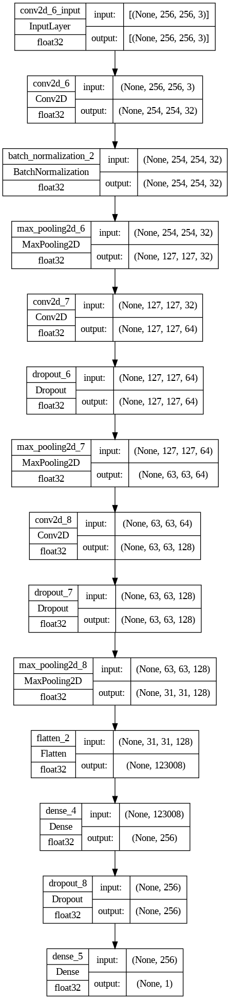

In [96]:
plot_model(Model, to_file="Model_One.png", show_layer_names=True, show_dtype=True, show_shapes=True)

In [99]:
Model_Results = Model.evaluate(Test_IMG_Set)
print("LOSS: " + "%.4f" % Model_Results[0])
print("ACCURACY: " + "%.2f" % Model_Results[1])

4/4 [==============================] - 2s 259ms/step - loss: 0.6931 - accuracy: 0.5000
LOSS: 0.6931
ACCURACY: 0.50


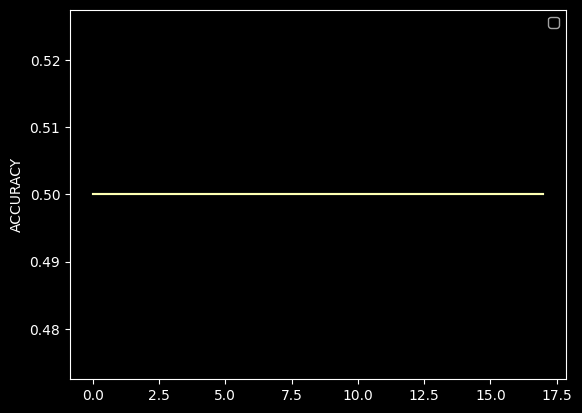

In [100]:
plt.plot(CNN_Model.history["accuracy"])
plt.plot(CNN_Model.history["val_accuracy"])
plt.ylabel("ACCURACY")
plt.legend()
plt.show()

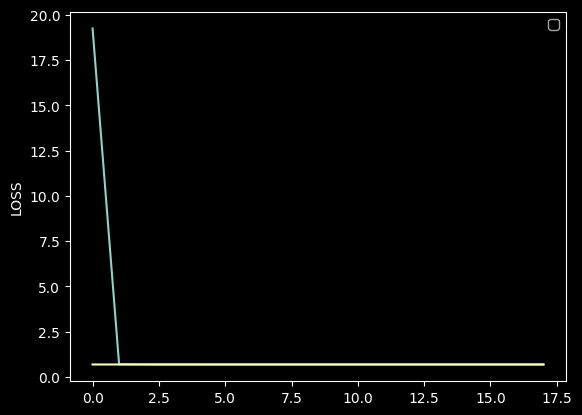

In [101]:
plt.plot(CNN_Model.history["loss"])
plt.plot(CNN_Model.history["val_loss"])
plt.ylabel("LOSS")
plt.legend()
plt.show()

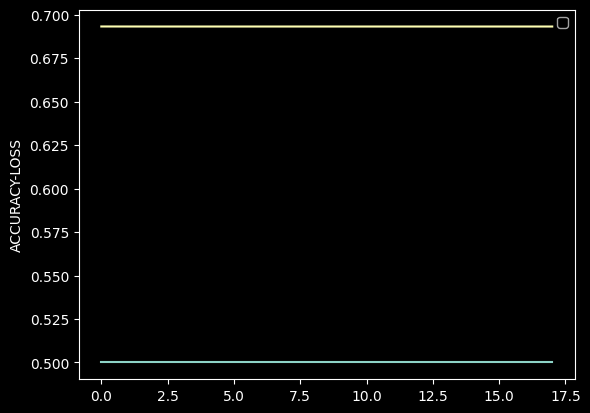

In [102]:
plt.plot(CNN_Model.history["val_accuracy"])
plt.plot(CNN_Model.history["val_loss"])
plt.ylabel("ACCURACY-LOSS")
plt.legend()
plt.show()

<Axes: >

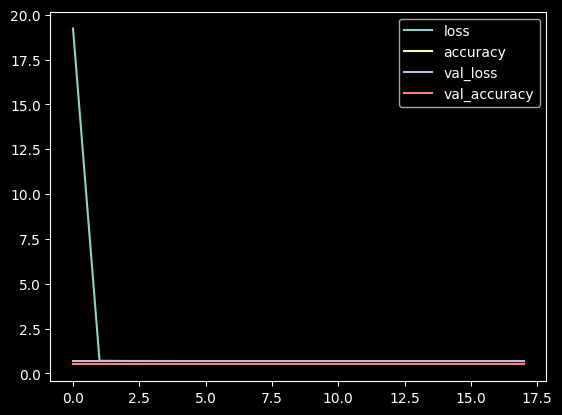

In [103]:
Dict_Summary_One = pd.DataFrame(CNN_Model.history)
Dict_Summary_One.plot()

## Predictions of model one

In [104]:
Prediction_One = Model.predict(Test_IMG_Set)
Prediction_One = Prediction_One.argmax(axis=-1)

4/4 [==============================] - 3s 485ms/step


In [105]:
print(Prediction_One)

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


In [108]:
Predict_Class = (Model.predict(Test_IMG_Set) > 0.5).astype("int32")

4/4 [==============================] - 2s 443ms/step


In [109]:
print(Predict_Class)

[[0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [1]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [1]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [1]
 [0]
 [0]
 [0]
 [0]
 [1]
 [0]
 [0]
 [0]
 [0]
 [0]
 [1]
 [0]
 [0]
 [0]
 [0]
 [1]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [1]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]
 [0]]


Here,

`0`: `FIRE`

`1`: `NO_FIRE`

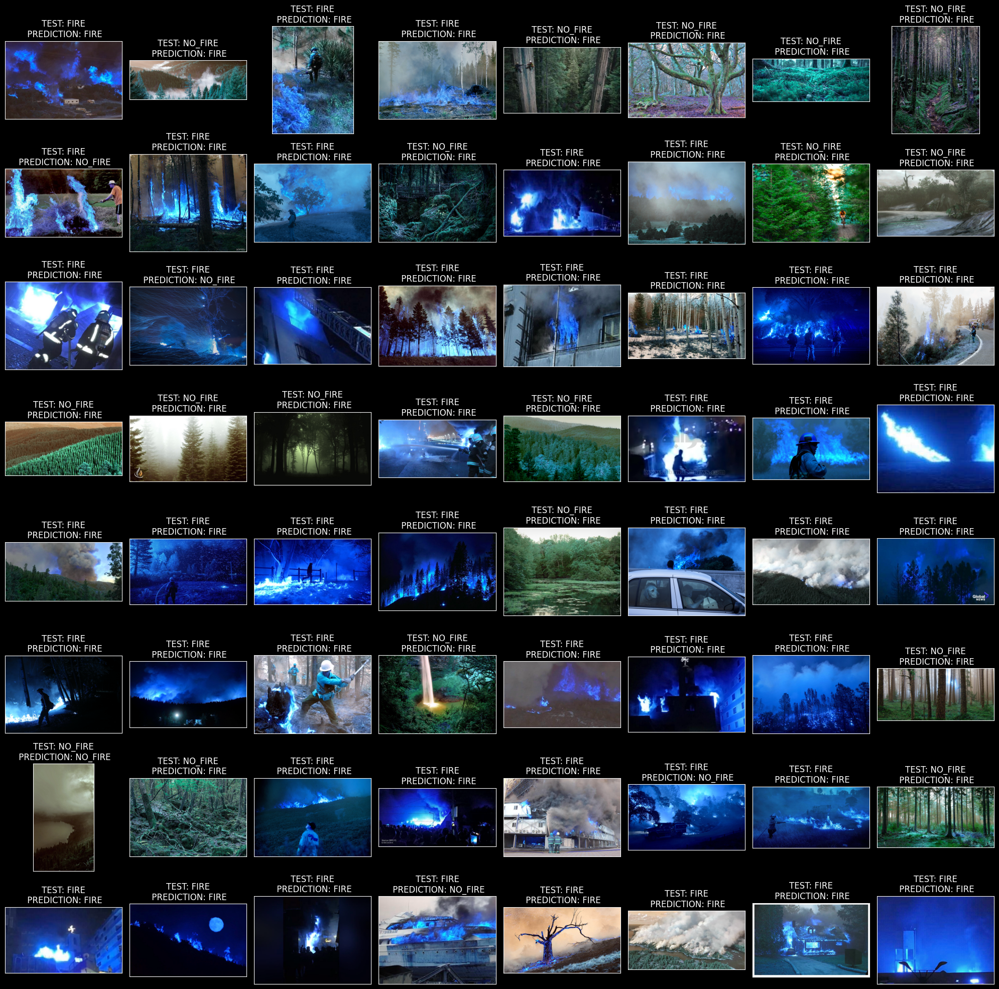

In [112]:
fig, axes = plt.subplots(nrows=8,
                         ncols=8,
                         figsize=(20, 20),
                         subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
  ax.imshow(cv2.imread(Test_Data["PNG"].iloc[i]))
  predicted_class = "FIRE" if Predict_Class[i] == [0] else "NO_FIRE"
  ax.set_title(f"TEST: {Test_Data.CATEGORY.iloc[i]}\n PREDICTION: {predicted_class}")

plt.tight_layout()
plt.show()

In [114]:
print(confusion_matrix(For_Prediction_Class, Predict_Class))

[[68  6]
 [25  1]]


In [116]:
print(classification_report(For_Prediction_Class, Predict_Class))

              precision    recall  f1-score   support

           0       0.73      0.92      0.81        74
           1       0.14      0.04      0.06        26

    accuracy                           0.69       100
   macro avg       0.44      0.48      0.44       100
weighted avg       0.58      0.69      0.62       100



## Using different source to check the model

## First, for a fire image

In [117]:
image_path = "Fire-Detection/1/12.jpg"
img = image.load_img(image_path, target_size=(256, 256))
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)

In [118]:
Diff_Pred = Model.predict(x)
Diff_Pred = Diff_Pred.argmax(axis=-1)
print(Diff_Pred)

1/1 [==============================] - 0s 465ms/step
[0]


## Now, for a no_fire image

In [119]:
image_path_Two = "Fire-Detection/0/12.jpg"
img_Two = image.load_img(image_path_Two, target_size=(256, 256))
x_Two = image.img_to_array(img_Two)
x_Two = np.expand_dims(x_Two, axis=0)

In [120]:
Diff_Pred_Two = Model.predict(x_Two)
Diff_Pred_Two = Diff_Pred_Two.argmax(axis=-1)
print(Diff_Pred_Two)

1/1 [==============================] - 0s 32ms/step
[0]


So, this model doesn't seem to be so reliable, it showed a model accuracy of 50%, showed 69% accuracy on the test dataset, and also didn't work well on the other dataset.

So, let's now build a fully-connected NN to see if it works better.

# Fully-Connected

In [123]:
Model_Two = tf.keras.models.Sequential([
  # Inputs
  tf.keras.layers.experimental.preprocessing.Rescaling(1./255),
  tf.keras.layers.Flatten(input_shape=(256,)),
  # Hiddens layers
  tf.keras.layers.Dense(128, activation='relu'),
  tf.keras.layers.Dense(64, activation='relu'),
  tf.keras.layers.Dropout(0.2),
  # Output layer
  tf.keras.layers.Dense(2, activation="softmax")
])

In [124]:
Model_Two.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])

In [125]:
ANN_Model = Model_Two.fit(Train_IMG_Set, validation_data=Validation_IMG_Set, callbacks=Call_Back, epochs=100)

Epoch 1/100
26/26 [==============================] - 31s 1s/step - loss: 0.5060 - accuracy: 0.7738 - val_loss: 0.4278 - val_accuracy: 0.7416
Epoch 2/100
26/26 [==============================] - 29s 1s/step - loss: 0.3572 - accuracy: 0.8418 - val_loss: 0.3950 - val_accuracy: 0.7753
Epoch 3/100
26/26 [==============================] - 28s 1s/step - loss: 0.2848 - accuracy: 0.8826 - val_loss: 0.2908 - val_accuracy: 0.8764
Epoch 4/100
26/26 [==============================] - 28s 1s/step - loss: 0.2582 - accuracy: 0.8949 - val_loss: 0.2513 - val_accuracy: 0.8876
Epoch 5/100
26/26 [==============================] - 29s 1s/step - loss: 0.2913 - accuracy: 0.8752 - val_loss: 0.2062 - val_accuracy: 0.9438
Epoch 6/100
26/26 [==============================] - 28s 1s/step - loss: 0.2423 - accuracy: 0.9110 - val_loss: 0.2161 - val_accuracy: 0.9438
Epoch 7/100
26/26 [==============================] - 29s 1s/step - loss: 0.1864 - accuracy: 0.9357 - val_loss: 0.4321 - val_accuracy: 0.7978
Epoch 8/100
2

In [126]:
print(Model_Two.summary())

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_1 (Rescaling)     (None, None, None, None   0         
                             )                                   
                                                                 
 flatten_4 (Flatten)         (None, None)              0         
                                                                 
 dense_9 (Dense)             (None, 128)               25165952  
                                                                 
 dense_10 (Dense)            (None, 64)                8256      
                                                                 
 dropout_10 (Dropout)        (None, 64)                0         
                                                                 
 dense_11 (Dense)            (None, 2)                 130       
                                                      

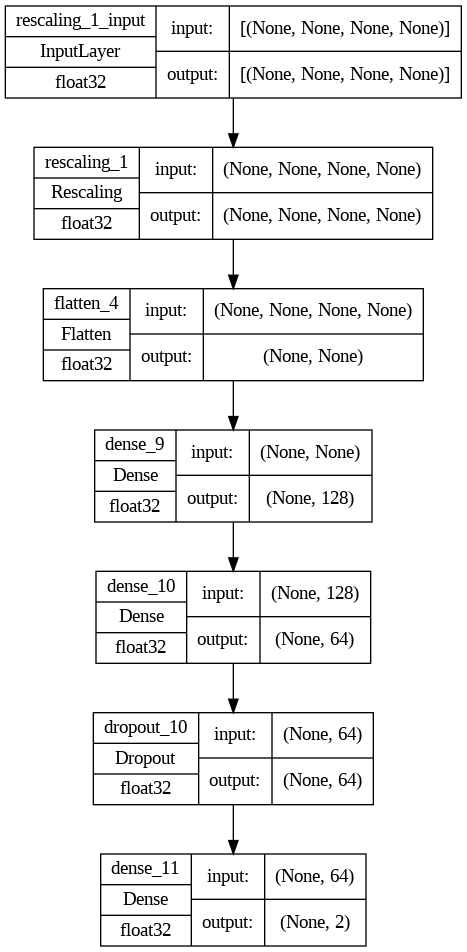

In [127]:
plot_model(Model_Two, to_file="Model_Two.png", show_layer_names=True, show_dtype=True, show_shapes=True)

In [128]:
Model_Results_Two = Model_Two.evaluate(Test_IMG_Set)
print("LOSS: " + "%.4f" % Model_Results_Two[0])
print("ACCURACY: " + "%.2f" % Model_Results_Two[1])

4/4 [==============================] - 3s 760ms/step - loss: 0.0743 - accuracy: 0.9700
LOSS: 0.0743
ACCURACY: 0.97


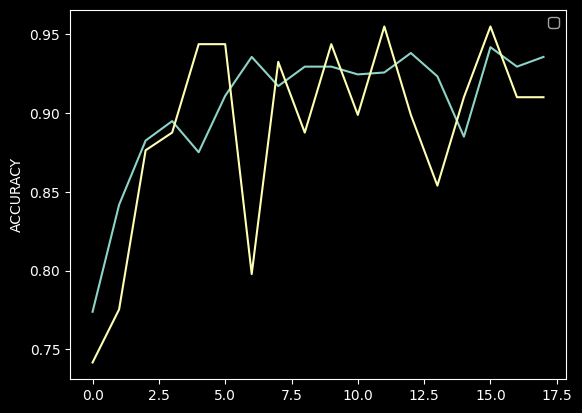

In [129]:
plt.plot(ANN_Model.history["accuracy"])
plt.plot(ANN_Model.history["val_accuracy"])
plt.ylabel("ACCURACY")
plt.legend()
plt.show()

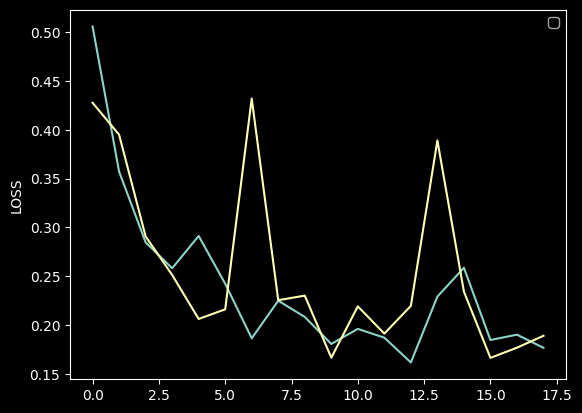

In [130]:
plt.plot(ANN_Model.history["loss"])
plt.plot(ANN_Model.history["val_loss"])
plt.ylabel("LOSS")
plt.legend()
plt.show()

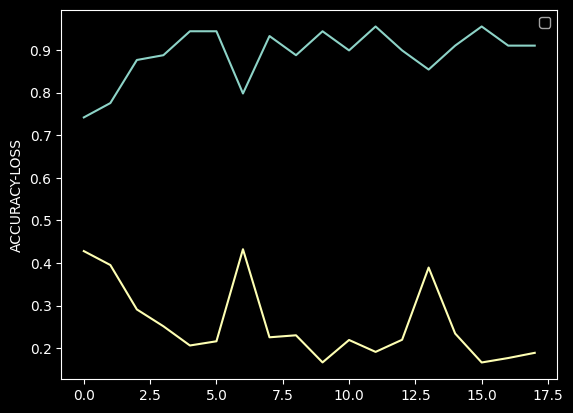

In [131]:
plt.plot(ANN_Model.history["val_accuracy"])
plt.plot(ANN_Model.history["val_loss"])
plt.ylabel("ACCURACY-LOSS")
plt.legend()
plt.show()

<Axes: >

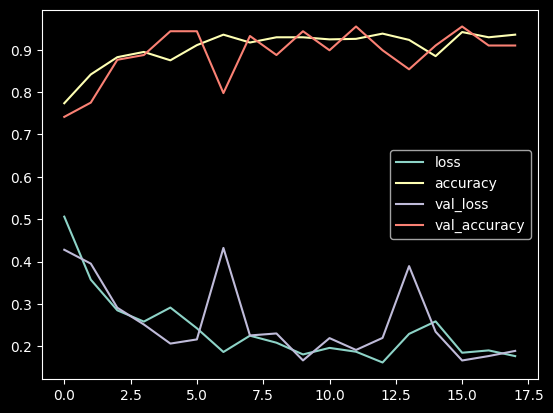

In [132]:
Dict_Summary_Two = pd.DataFrame(ANN_Model.history)
Dict_Summary_Two.plot()

## Predictions of model two

In [133]:
Prediction_Two = Model_Two.predict(Test_IMG_Set)
Prediction_Two = Prediction_Two.argmax(axis=-1)

4/4 [==============================] - 2s 609ms/step


In [134]:
print(Prediction_Two)

[0 0 1 0 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 1 0 0 0 1 1
 0 1 0 1 1 1 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0
 0 0 0 0 0 1 0 0 1 0 1 0 0 1 0 0 1 1 0 0 0 1 0 0 0 0]


In [144]:
Predict_Class_Two = (Model_Two.predict(Test_IMG_Set) > 0.5).astype('int32')

4/4 [==============================] - 2s 487ms/step


In [146]:
print(Predict_Class_Two)

[[1 0]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [0 1]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [0 1]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [0 1]
 [0 1]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]]


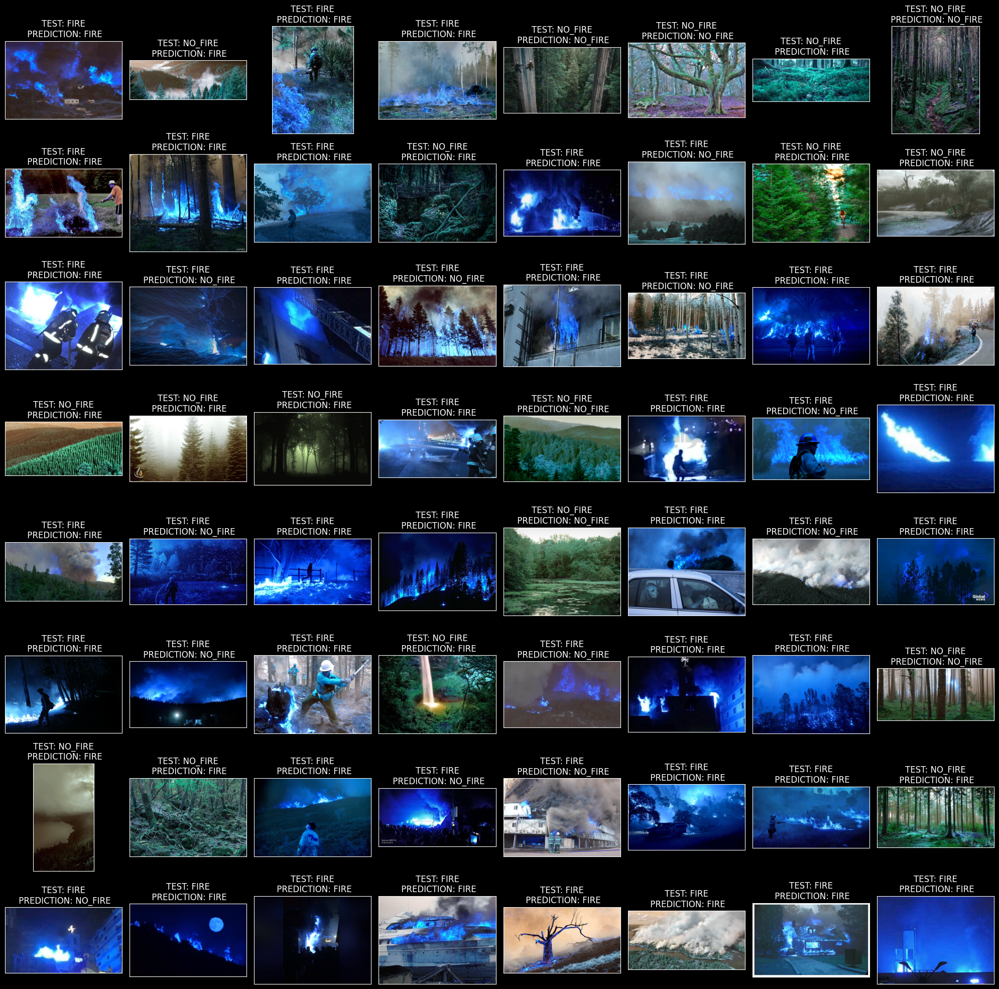

In [149]:
fig, axes = plt.subplots(nrows=8, ncols=8, figsize=(20, 20), subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
  ax.imshow(cv2.imread(Test_Data["PNG"].iloc[i]))
  predicted_class = "FIRE" if Predict_Class_Two[i][0] == 1 else "NO_FIRE"
  ax.set_title(f"TEST: {Test_Data.CATEGORY.iloc[i]}\n PREDICTION: {predicted_class}")

plt.tight_layout()
plt.show()

In [153]:
final_prediction_class_two = [0 if i[0] == 1 else 1 for i in Predict_Class_Two]
print(confusion_matrix(For_Prediction_Class, final_prediction_class_two))

[[57 17]
 [18  8]]


In [154]:
print(classification_report(For_Prediction_Class, final_prediction_class_two))

              precision    recall  f1-score   support

           0       0.76      0.77      0.77        74
           1       0.32      0.31      0.31        26

    accuracy                           0.65       100
   macro avg       0.54      0.54      0.54       100
weighted avg       0.65      0.65      0.65       100



## Using different source to check the model predictions

## First, for a fire image

In [155]:
image_path = "Fire-Detection/1/12.jpg"
img = image.load_img(image_path, target_size=(256, 256))
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)

In [156]:
Diff_Pred = Model_Two.predict(x)
Diff_Pred = Diff_Pred.argmax(axis=-1)
print(Diff_Pred)

1/1 [==============================] - 0s 60ms/step
[0]


## Now, for a no_fire image

In [157]:
image_path_Two = "Fire-Detection/0/12.jpg"
img_Two = image.load_img(image_path_Two, target_size=(256, 256))
x_Two = image.img_to_array(img_Two)
x_Two = np.expand_dims(x_Two, axis=0)

In [158]:
Diff_Pred_Two = Model_Two.predict(x_Two)
Diff_Pred_Two = Diff_Pred_Two.argmax(axis=-1)
print(Diff_Pred_Two)

1/1 [==============================] - 0s 32ms/step
[1]


Here, we see that this model is much better, it showed a model accuracy of 97%, worked with 65% accuracy on the test dataset, and worked just fine with the other dataset. So, this model is a bit reliable.

Anyways, let's check if RCNN could work better than this.

# CNN-RCNN

In [159]:
Model_Three = Sequential()

Model_Three.add(Conv2D(12, (3, 3), activation="relu", input_shape=(256, 256, 3)))
Model_Three.add(BatchNormalization())
Model_Three.add(MaxPooling2D((2, 2)))

Model_Three.add(Conv2D(24, (3, 3), activation="relu"))
Model_Three.add(Dropout(0.2))
Model_Three.add(MaxPooling2D((2, 2)))

Model_Three.add(TimeDistributed(Flatten()))
Model_Three.add(Bidirectional(LSTM(32, return_sequences=True, dropout=0.5, recurrent_dropout=0.5)))
Model_Three.add(Bidirectional(GRU(32, return_sequences=True, dropout=0.5, recurrent_dropout=0.5)))

Model_Three.add(Flatten())

Model_Three.add(Dense(256, activation="relu"))
Model_Three.add(Dropout(0.5))
Model_Three.add(Dense(2, activation="softmax"))

In [161]:
Model_Three.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])

In [162]:
RCNN_Model = Model_Three.fit(Train_IMG_Set, validation_data=Validation_IMG_Set, callbacks=Call_Back, epochs=100)

Epoch 1/100
26/26 [==============================] - 65s 2s/step - loss: 0.3735 - accuracy: 0.8529 - val_loss: 0.4806 - val_accuracy: 0.7528
Epoch 2/100
26/26 [==============================] - 50s 2s/step - loss: 0.1807 - accuracy: 0.9209 - val_loss: 0.4059 - val_accuracy: 0.7528
Epoch 3/100
26/26 [==============================] - 46s 2s/step - loss: 0.1813 - accuracy: 0.9333 - val_loss: 0.5965 - val_accuracy: 0.7528
Epoch 4/100
26/26 [==============================] - 46s 2s/step - loss: 0.1723 - accuracy: 0.9357 - val_loss: 0.3511 - val_accuracy: 0.7640
Epoch 5/100
26/26 [==============================] - 46s 2s/step - loss: 0.1607 - accuracy: 0.9382 - val_loss: 0.3689 - val_accuracy: 0.7528
Epoch 6/100
26/26 [==============================] - 48s 2s/step - loss: 0.1632 - accuracy: 0.9370 - val_loss: 0.3545 - val_accuracy: 0.7528
Epoch 7/100
26/26 [==============================] - 47s 2s/step - loss: 0.1346 - accuracy: 0.9456 - val_loss: 0.6322 - val_accuracy: 0.7528
Epoch 8/100
2

In [163]:
print(Model_Three.summary())

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 254, 254, 12)      336       
                                                                 
 batch_normalization_3 (Bat  (None, 254, 254, 12)      48        
 chNormalization)                                                
                                                                 
 max_pooling2d_9 (MaxPoolin  (None, 127, 127, 12)      0         
 g2D)                                                            
                                                                 
 conv2d_10 (Conv2D)          (None, 125, 125, 24)      2616      
                                                                 
 dropout_11 (Dropout)        (None, 125, 125, 24)      0         
                                                                 
 max_pooling2d_10 (MaxPooli  (None, 62, 62, 24)       

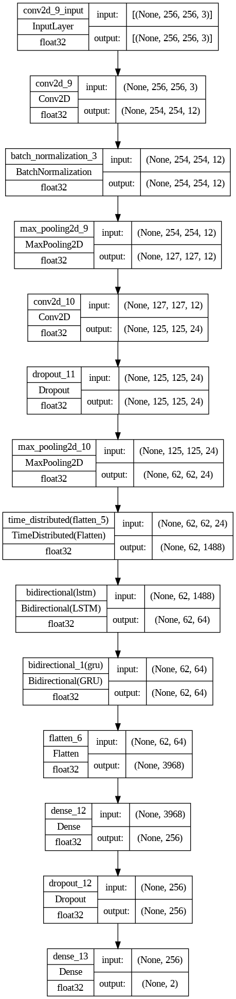

In [164]:
plot_model(Model_Three, to_file="Model_Three.png", show_layer_names=True, show_dtype=True, show_shapes=True)

In [165]:
Model_Results_Three = Model_Three.evaluate(Test_IMG_Set)
print("LOSS: " + "%.4f" % Model_Results_Three[0])
print("ACCURACY: " + "%.2f" % Model_Results_Three[1])

4/4 [==============================] - 3s 565ms/step - loss: 0.0922 - accuracy: 0.9500
LOSS: 0.0922
ACCURACY: 0.95


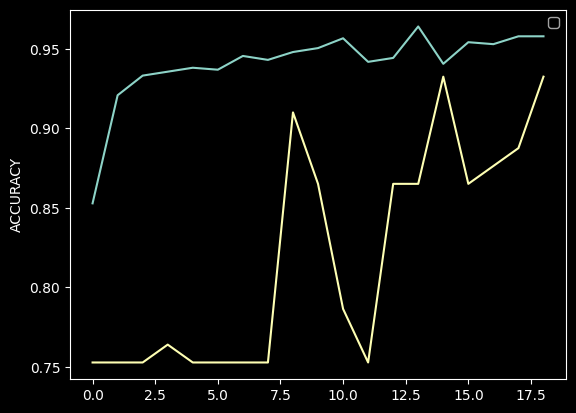

In [166]:
plt.plot(RCNN_Model.history["accuracy"])
plt.plot(RCNN_Model.history["val_accuracy"])
plt.ylabel("ACCURACY")
plt.legend()
plt.show()

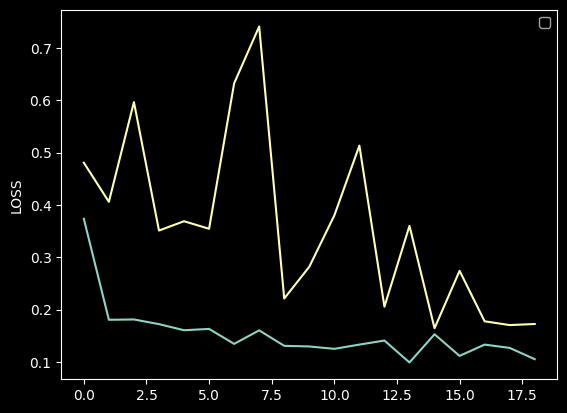

In [167]:
plt.plot(RCNN_Model.history["loss"])
plt.plot(RCNN_Model.history["val_loss"])
plt.ylabel("LOSS")
plt.legend()
plt.show()

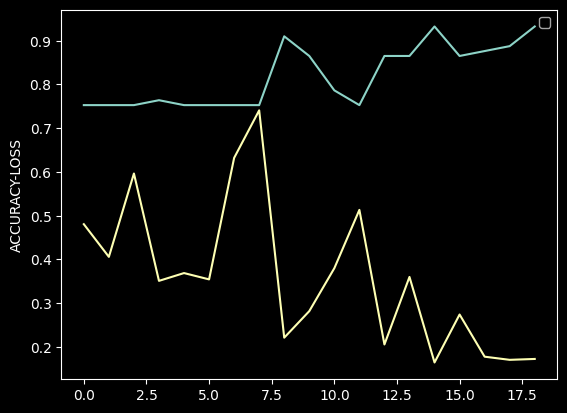

In [168]:
plt.plot(RCNN_Model.history["val_accuracy"])
plt.plot(RCNN_Model.history["val_loss"])
plt.ylabel("ACCURACY-LOSS")
plt.legend()
plt.show()

<Axes: >

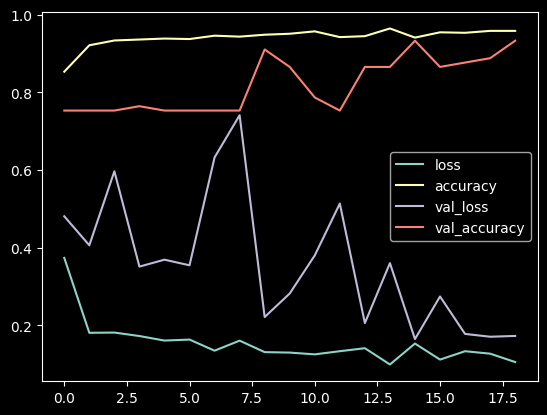

In [169]:
Dict_Summary_Three = pd.DataFrame(RCNN_Model.history)
Dict_Summary_Three.plot()

## Predictions of model three

In [170]:
Prediction_Three = Model_Three.predict(Test_IMG_Set)
Prediction_Three = Prediction_Three.argmax(axis=-1)

4/4 [==============================] - 3s 670ms/step


In [171]:
print(Prediction_Three)

[0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 1 0 0 0 0 0 1 0 0 0 1 1 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 1 1 0 0 1 0 1 1 1 1
 0 0 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]


In [172]:
Predict_Class_Three = (Model_Three.predict(Test_IMG_Set) > 0.5).astype('int32')

4/4 [==============================] - 2s 442ms/step


In [173]:
print(Predict_Class_Three)

[[1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [0 1]
 [1 0]
 [0 1]
 [0 1]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [1 0]
 [0 1]
 [1 0]
 [0 1]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [1 0]
 [0 1]
 [0 1]
 [1 0]
 [0 1]
 [1 0]
 [0 1]
 [0 1]
 [1 0]
 [1 0]
 [1 0]]


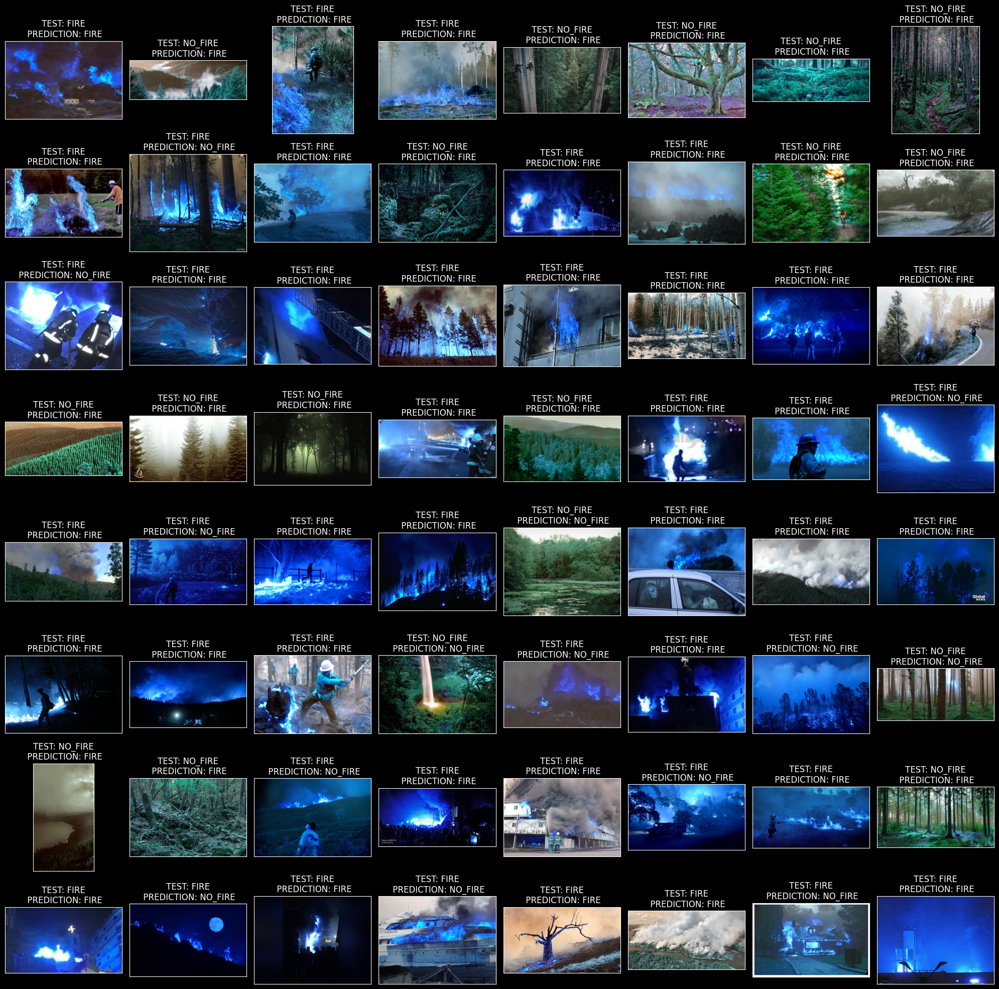

In [174]:
fig, axes = plt.subplots(nrows=8, ncols=8, figsize=(20, 20), subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
  ax.imshow(cv2.imread(Test_Data["PNG"].iloc[i]))
  predicted_class = "FIRE" if Predict_Class_Three[i][0] == 1 else "NO_FIRE"
  ax.set_title(f"TEST: {Test_Data.CATEGORY.iloc[i]}\n PREDICTION: {predicted_class}")

plt.tight_layout()
plt.show()

In [175]:
final_prediction_class_three = [0 if i[0] == 1 else 1 for i in Predict_Class_Three]
print(confusion_matrix(For_Prediction_Class, final_prediction_class_three))

[[56 18]
 [21  5]]


In [176]:
print(classification_report(For_Prediction_Class, final_prediction_class_three))

              precision    recall  f1-score   support

           0       0.73      0.76      0.74        74
           1       0.22      0.19      0.20        26

    accuracy                           0.61       100
   macro avg       0.47      0.47      0.47       100
weighted avg       0.59      0.61      0.60       100



## Using different source to check for model predictions

## First, on a fire image

In [177]:
image_path = "Fire-Detection/1/12.jpg"
img = image.load_img(image_path, target_size=(256, 256))
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)

In [178]:
Diff_Pred = Model_Three.predict(x)
Diff_Pred = Diff_Pred.argmax(axis=-1)
print(Diff_Pred)

1/1 [==============================] - 2s 2s/step
[0]


## Now, for a no_fire image

In [179]:
image_path_Two = "Fire-Detection/0/12.jpg"
img_Two = image.load_img(image_path_Two, target_size=(256, 256))
x_Two = image.img_to_array(img_Two)
x_Two = np.expand_dims(x_Two, axis=0)

In [180]:
Diff_Pred_Three = Model_Three.predict(x_Two)
Diff_Pred_Three = Diff_Pred_Three.argmax(axis=-1)
print(Diff_Pred_Three)

1/1 [==============================] - 0s 80ms/step
[0]


So ultimately, we have seen that the fully-connected neural network and the RCNN have worked efficiently at a rate of 95%-97%.